In [2]:
import pandas as pd
import matplotlib.pyplot as plt 
import seaborn as sns
import numpy as np
plt.style.use('fivethirtyeight')

from datetime import datetime

In [3]:
from sklearn import preprocessing
from sklearn import svm
import sklearn.metrics
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.preprocessing import StandardScaler
from imblearn.over_sampling import SMOTE,SMOTENC
from sklearn.preprocessing import normalize
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import GridSearchCV,RandomizedSearchCV
from sklearn.metrics import accuracy_score
from sklearn.metrics import recall_score, f1_score
import xgboost
from xgboost import XGBClassifier
from sklearn.model_selection import StratifiedKFold

In [202]:
#Affichage des 4 dataframes séparés 

In [4]:
lieux = pd.read_csv('https://www.data.gouv.fr/fr/datasets/r/8a4935aa-38cd-43af-bf10-0209d6d17434',sep= ";")
usagers = pd.read_csv('https://www.data.gouv.fr/fr/datasets/r/ba5a1956-7e82-41b7-a602-89d7dd484d7a',sep = ';')
vehicules = pd.read_csv('https://www.data.gouv.fr/fr/datasets/r/0bb5953a-25d8-46f8-8c25-b5c2f5ba905e', sep= ";")
caracteristiques = pd.read_csv('https://www.data.gouv.fr/fr/datasets/r/85cfdc0c-23e4-4674-9bcd-79a970d7269b',sep = ";")

In [ ]:
lieux.isnull().sum()

In [ ]:
caracteristiques.isnull().sum()

In [ ]:
vehicules.isnull().sum()

In [ ]:
usagers.isnull().sum()

In [ ]:
usagers["Num_Acc"].value_counts()

In [46]:
df1 = pd.merge(lieux,caracteristiques)
df1

,Num_Acc,catr,voie,v1,v2,circ,nbv,vosp,prof,pr,...,lum,dep,com,agg,int,atm,col,adr,lat,long
0,202100000001,3,981,-1,NaN,2,2,0,1,(1),...,2,30,30319,1,1,1,1,CD 981,"44,0389580000","4,3480220000"
1,202100000002,3,20,0,E,2,2,0,1,0,...,1,51,51544,1,3,1,3,Aire de repos croisement D20E9 après sortie D977,"49,2421290000","4,5545460000"
2,202100000003,4,GENERAL GALLIENI (BOULEVARD DU),0,NaN,2,2,0,1,(1),...,1,85,85048,2,1,7,6,15 rue François Nicolas,"46,9219500000","-0,9644600000"
3,202100000004,3,GENERAL GALLIENI (BOULEVARD DU),0,NaN,2,4,0,1,0,...,5,93,93005,2,2,3,6,Route de Mitry,"48,9493634583","2,5196639908"
4,202100000005,7,PARIS. ROUTE DE,-1,NaN,2,2,-1,1,11,...,5,76,76429,2,1,1,2,PARIS. ROUTE DE,"49,4083800000","1,1458100000"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
56513,202100056514,1,65,-1,NaN,3,4,0,2,0,...,3,33,33021,1,1,5,6,NaN,"44,5266190000","-0,1955440000"
56514,202100056515,3,520,0,D,2,2,0,1,46,...,1,38,38405,1,1,2,6,D520,"45,3802910000","5,7049140000"
56515,202100056516,3,538,-1,NaN,2,2,0,2,49,...,3,26,26064,1,1,2,1,Route départementale 538,"44,9112100000","5,0196360000"
56516,202100056517,4,NaN,-1,NaN,2,2,0,1,(1),...,1,33,33003,1,2,1,6,Voie rapide Bassens Ambes,"44,9542747363","-0,5179211363"


In [47]:
df2 = pd.merge(usagers,vehicules, how = 'left')
df2

,Num_Acc,id_vehicule,num_veh,place,catu,grav,sexe,an_nais,trajet,secu1,...,actp,etatp,senc,catv,obs,obsm,choc,manv,motor,occutc
0,202100000001,201 764,B01,1,1,3,1,2000.0,1,0,...,0,-1,1,1,0,2,1,1,5,NaN
1,202100000001,201 765,A01,1,1,1,1,1978.0,1,1,...,0,-1,1,7,0,9,3,17,1,NaN
2,202100000002,201 762,A01,1,1,4,1,1983.0,0,1,...,0,-1,0,7,2,2,1,1,0,NaN
3,202100000002,201 763,B01,1,1,3,1,1993.0,0,1,...,0,-1,0,7,0,2,1,9,0,NaN
4,202100000003,201 761,A01,1,1,1,1,1995.0,1,1,...,0,-1,1,7,0,1,3,1,1,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
129148,202100056516,100 885,A01,1,1,4,1,1975.0,0,1,...,0,-1,1,7,0,2,1,5,1,NaN
129149,202100056516,100 886,B01,1,1,4,1,2002.0,5,1,...,0,-1,2,7,0,2,3,1,1,NaN
129150,202100056517,100 884,A01,1,1,3,1,1999.0,0,0,...,0,-1,2,7,6,0,5,6,1,NaN
129151,202100056518,100 882,A01,1,1,3,1,1968.0,3,1,...,-1,-1,2,7,0,2,1,6,1,NaN


In [48]:
df = pd.merge(df2,df1,how = 'left')
df

,Num_Acc,id_vehicule,num_veh,place,catu,grav,sexe,an_nais,trajet,secu1,...,lum,dep,com,agg,int,atm,col,adr,lat,long
0,202100000001,201 764,B01,1,1,3,1,2000.0,1,0,...,2,30,30319,1,1,1,1,CD 981,"44,0389580000","4,3480220000"
1,202100000001,201 765,A01,1,1,1,1,1978.0,1,1,...,2,30,30319,1,1,1,1,CD 981,"44,0389580000","4,3480220000"
2,202100000002,201 762,A01,1,1,4,1,1983.0,0,1,...,1,51,51544,1,3,1,3,Aire de repos croisement D20E9 après sortie D977,"49,2421290000","4,5545460000"
3,202100000002,201 763,B01,1,1,3,1,1993.0,0,1,...,1,51,51544,1,3,1,3,Aire de repos croisement D20E9 après sortie D977,"49,2421290000","4,5545460000"
4,202100000003,201 761,A01,1,1,1,1,1995.0,1,1,...,1,85,85048,2,1,7,6,15 rue François Nicolas,"46,9219500000","-0,9644600000"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
129148,202100056516,100 885,A01,1,1,4,1,1975.0,0,1,...,3,26,26064,1,1,2,1,Route départementale 538,"44,9112100000","5,0196360000"
129149,202100056516,100 886,B01,1,1,4,1,2002.0,5,1,...,3,26,26064,1,1,2,1,Route départementale 538,"44,9112100000","5,0196360000"
129150,202100056517,100 884,A01,1,1,3,1,1999.0,0,0,...,1,33,33003,1,2,1,6,Voie rapide Bassens Ambes,"44,9542747363","-0,5179211363"
129151,202100056518,100 882,A01,1,1,3,1,1968.0,3,1,...,3,78,78423,1,1,3,1,VOLTA (AVENUE),"48,7966700000","2,0505000000"


In [15]:
missing_values = df.isnull().sum().sort_values(ascending=False)
missing_percentages = df.isna().sum().sort_values(ascending=False)/len(df)
#missing_percentages, missing_values

In [242]:
df.dtypes

Num_Acc          int64
id_vehicule     object
num_veh         object
place            int64
catu             int64
grav             int64
sexe             int64
an_nais        float64
trajet           int64
secu1            int64
secu2            int64
secu3            int64
locp             int64
actp            object
etatp            int64
senc             int64
catv             int64
obs              int64
obsm             int64
choc             int64
manv             int64
motor            int64
occutc         float64
catr             int64
voie            object
v1               int64
v2              object
circ             int64
nbv              int64
vosp             int64
prof             int64
pr              object
pr1             object
plan             int64
lartpc          object
larrout         object
surf             int64
infra            int64
situ             int64
vma              int64
jour             int64
mois             int64
an               int64
hrmn       

On sait que les colonnes lartpc, occutc, v2 correspondsant respectivement à la largeur du terre-plein central (TPC) s'il existe (en m, au nombre d’occupants dans le transport en commun) et à la lettre indice alphanumérique de la route comportent plus de 90% de valeurs manquantes NaN donc on peut retirer ses colonnes immédiatement du dataset.  

In [8]:
df2 = df.copy()

In [8]:
df.drop(['lartpc','occutc','v2'],axis = 1,inplace = True)

On enlève aussi les colonnes Num_Acc, id_vehicule et Num_Veh qui sont des clés que nous avons utilisé pour merge nos DataFrame.

In [9]:
df.drop(['Num_Acc','id_vehicule','num_veh'],axis = 1,inplace = True)

On peut aussi enlever les colonnes pr, pr1, voie, v1 et senc correspondant respectivement au numéro du PR de rattachement (numéro de la borne amont), à la distance en mètres au PR, au numéro de la route, à l'indice numérique du numéro de route et au sens de circulation car ils ne sont pas utiles pour prédire la gravité d'un accident. 

In [10]:
df.drop(['pr','pr1','voie','v1','senc'],axis = 1,inplace = True)

In [11]:
df.columns

Index(['place', 'catu', 'grav', 'sexe', 'an_nais', 'trajet', 'secu1', 'secu2',
       'secu3', 'locp', 'actp', 'etatp', 'catv', 'obs', 'obsm', 'choc', 'manv',
       'motor', 'catr', 'circ', 'nbv', 'vosp', 'prof', 'plan', 'larrout',
       'surf', 'infra', 'situ', 'vma', 'jour', 'mois', 'an', 'hrmn', 'lum',
       'dep', 'com', 'agg', 'int', 'atm', 'col', 'adr', 'lat', 'long'],
      dtype='object')

In [49]:
# EXPLIQUER LE BUT DE CETTE CELLULE
import re 

def cleanData(data):
    data = re.sub(',','.',data) 
    return data

df['lat2']=df['lat'].apply(cleanData)
df['long2']=df['long'].apply(cleanData)

df["lat2"] = pd.to_numeric(df["lat2"])
df["long2"] = pd.to_numeric(df["long2"])

df.drop(['lat','long'],axis = 1,inplace = True)

In [50]:
# La colonne actp contenait des nombres convertis en string donc on la repasse en float

def cleanData2(data):
    data = re.sub(',','.',data) 
    data = re.sub('B','-1',data)
    data = re.sub('A','9',data)
    return data

df['larrout']=df['larrout'].apply(cleanData2)
df['larrout'] = pd.to_numeric(df['larrout'])

df['actp']=df['actp'].apply(cleanData2)
df['actp'] = pd.to_numeric(df['actp'])

In [51]:
def time(data):
    return datetime.strptime(data, "%H:%M").time()

df['hrmn']=df['hrmn'].apply(time)

In [52]:
# Calculer le nombre de -1 dans chaque colonne car ces valeurs signifient : informations non renseignées

def renseignement():
    L = []
    for col in list(df):
        L.append(len(df[df[col]==-1])/df.shape[0])
    return L

liste = renseignement()

# Indices des colonnes contenant plus de 20% de valeur -1 correspondant à des valeurs non renseignées 

def indices(liste):
    indices = []
    longueur = len(liste)
    for i in range(longueur):
        taux = liste[i]
        if taux > 0.2:
            indices.append(i)
    return indices
            
indices = indices(liste) 
df.columns[indices]

Index(['secu2', 'secu3', 'locp', 'actp', 'etatp', 'larrout'], dtype='object')

Ces indices correspondent aux colonnes secu2, secu3, locp, actp et etatp et larrout correspondant respectivement aux renseignements du caractère indiquant la présence et l’utilisation de l’équipement de sécurité pour secu2 et 3, à la localisation du piéton pour locp, à une variable permettant de préciser si le piéton accidenté était seul ou non pour etatp et à la largeur de la chaussée affectée à la circulation des véhicules pour larrout. 
On peut donc supprimer ces colonnes de notre dataset. 

In [53]:
# On retire donc ces 6 colonnes de notre dataset
df.drop(df.columns[indices], axis = 1, inplace = True)

In [17]:
df.var().sort_values()

/var/folders/w0/ddz0qbqx0_30722ndkqpl39r0000gn/T/ipykernel_74638/354554810.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  df.var().sort_values()


an         5.169919e-26
agg        2.343218e-01
prof       2.919613e-01
sexe       3.353610e-01
catu       3.643739e-01
plan       4.421354e-01
vosp       4.471217e-01
surf       6.533142e-01
circ       8.295631e-01
motor      9.377875e-01
obsm       1.517202e+00
catr       1.887285e+00
grav       1.908872e+00
nbv        2.022802e+00
lum        2.063962e+00
situ       2.116854e+00
atm        2.879898e+00
col        3.414777e+00
int        4.034135e+00
infra      4.534795e+00
secu1      5.015950e+00
choc       5.729715e+00
place      6.380128e+00
trajet     7.781688e+00
obs        1.016322e+01
mois       1.080928e+01
manv       6.620571e+01
jour       7.732610e+01
lat2       1.502133e+02
catv       1.762152e+02
an_nais    3.513547e+02
long2      3.682922e+02
vma        7.107904e+02
dtype: float64

In [18]:
df.columns

Index(['place', 'catu', 'grav', 'sexe', 'an_nais', 'trajet', 'secu1', 'catv',
       'obs', 'obsm', 'choc', 'manv', 'motor', 'catr', 'circ', 'nbv', 'vosp',
       'prof', 'plan', 'surf', 'infra', 'situ', 'vma', 'jour', 'mois', 'an',
       'hrmn', 'lum', 'dep', 'com', 'agg', 'int', 'atm', 'col', 'adr', 'lat2',
       'long2'],
      dtype='object')

[Text(0.5, 1.0, 'matrice de corrélation de plusieurs features')]

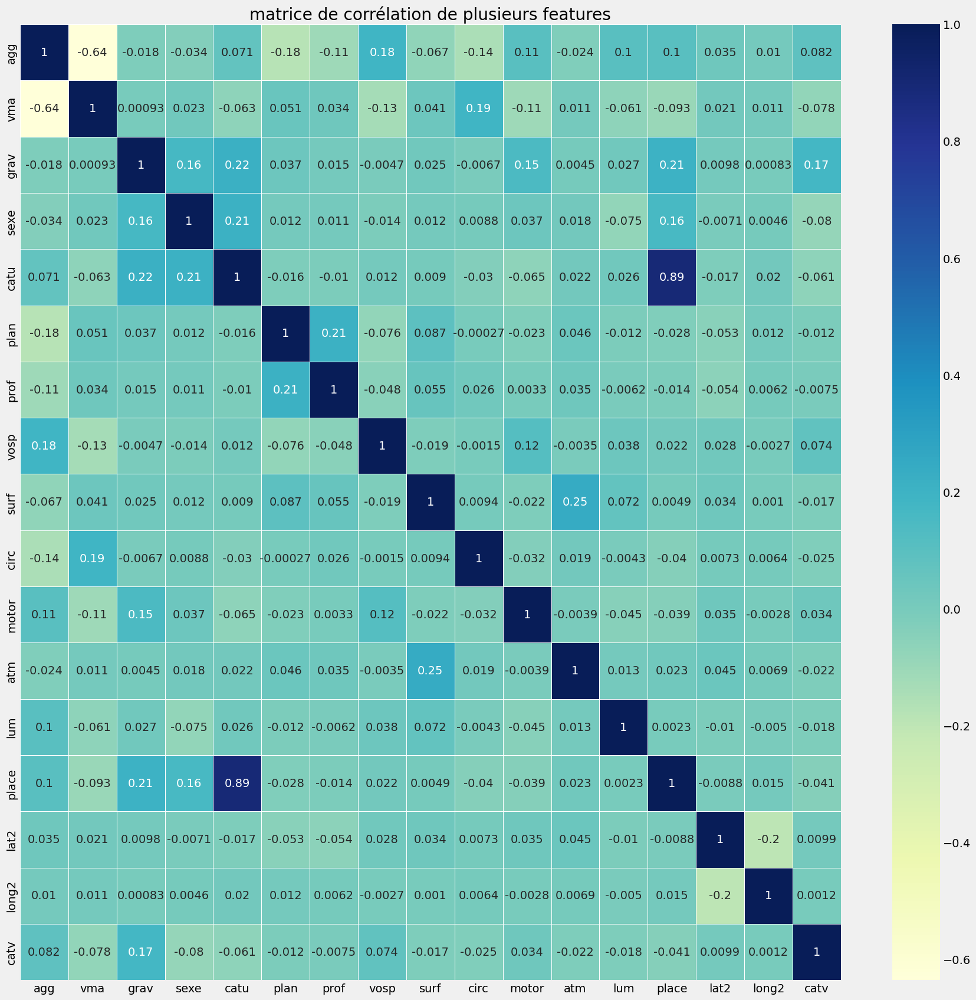

In [54]:
plt.figure(figsize=(20,20))
sns.heatmap(df[['agg','vma','grav','sexe', 'catu', 'plan','prof', 'vosp', 'surf',
                'circ','motor','atm','lum','place','lat2','long2',
                'catv']].corr(),annot=True,linewidth=.5,cmap='YlGnBu').set(title = "matrice de corrélation de plusieurs features")

On supprime directement la colonne an : nous n'avons que des données de 2021.

Les colonnes prof, catu, plan, vosp et circ correspondant respectivement au profil en long décrivant la déclivité de la route à l'endroit de l'accident, la catégorie d'usager, le tracé en plan, l’existence d’une voie réservée, indépendamment du fait que l’accident ait lieu ou non sur cette voie, le régime de circulation ont des variances très faibles, entre 0.1 et 1, pour des variables catégorielles non binaires, donc on peut les retirer des features aidant à la prédiction de notre modèle. 

De plus, la heatmap montre que 'catu' et 'place' ont une corrélation de 0.89 donc on peut garder uniquement 'place' en feature. De même, 'surf' et 'atm' sont corrélés à 0.25 donc on ne peut en garder qu'un seul en feature. Aussi, 'agg' et 'vma'(vitesse maximale autorisée sur la portion de route correspondante) sont très corrélés négatvement (-0.64) donc on peut ne garder que vma en feature. De plus, 'vosp' est corrélé à 'agg' corrélé à 'vma' donc on peut les enlever aussi. 'Circ' a une corrélation significative de 0.19 avec 'vma' donc on peut aussi le retirer du datset pour la prédiction. 

[Text(0.5, 1.0, 'matrice de corrélation de plusieurs features')]

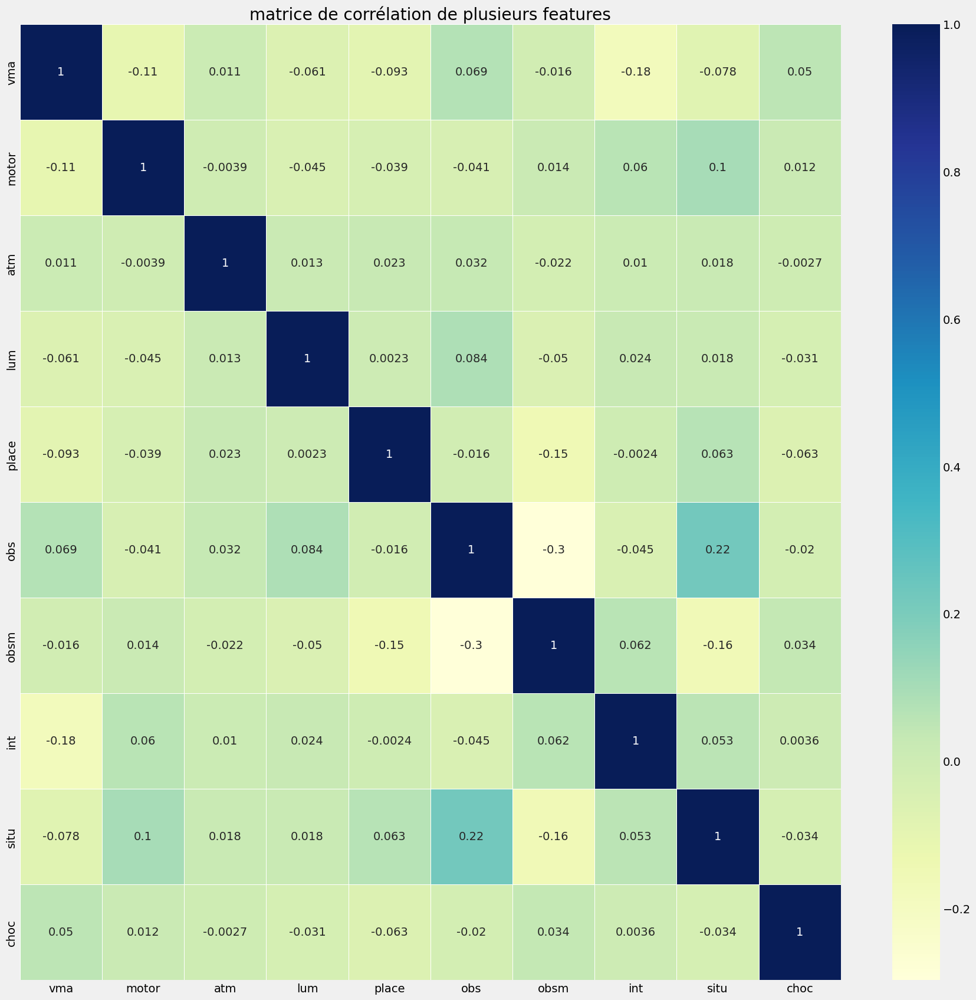

In [55]:
plt.figure(figsize=(20,20))
sns.heatmap(df[['vma','motor','atm','lum','place','obs','obsm','int','situ',
                'choc']].corr(),annot=True,linewidth=.5,cmap='YlGnBu').set(title = "matrice de corrélation de plusieurs features")

[Text(0.5, 1.0, 'matrice de corrélation de plusieurs features')]

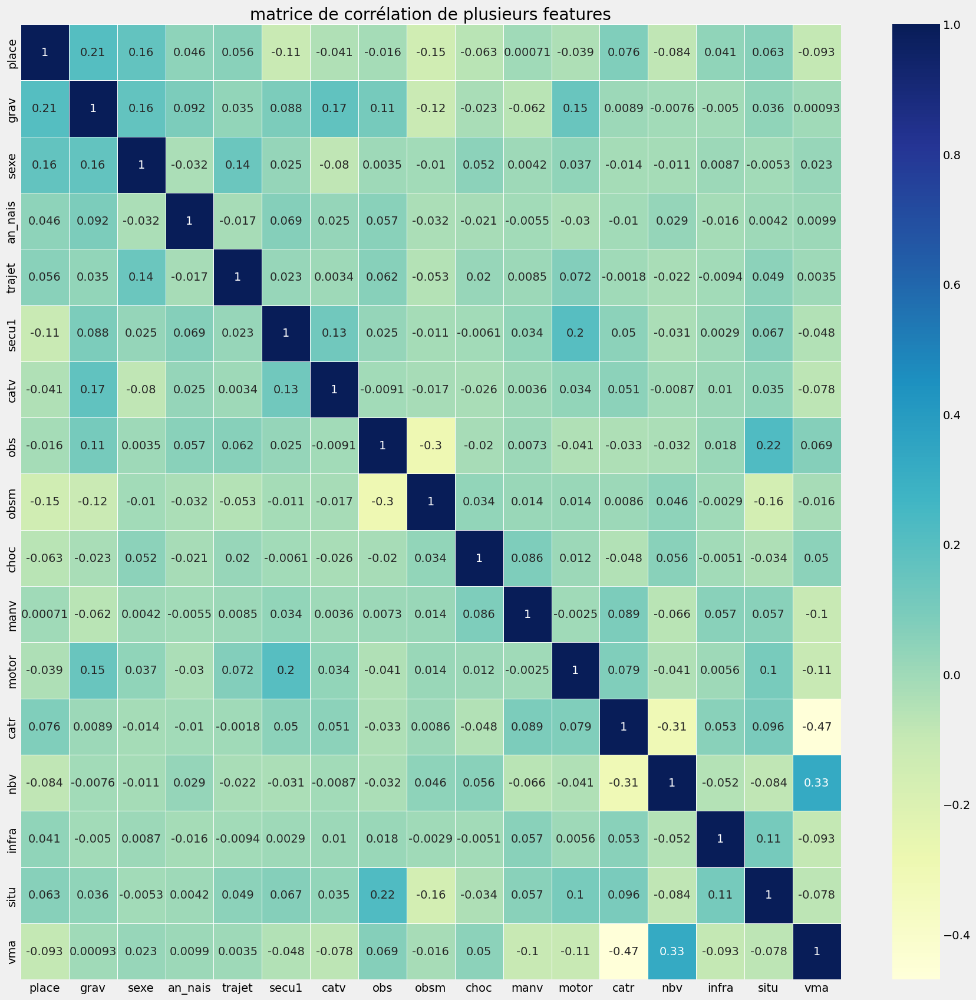

In [56]:
plt.figure(figsize=(20,20))
sns.heatmap(df[['place','grav', 'sexe', 'an_nais', 'trajet', 'secu1',
       'catv', 'obs', 'obsm', 'choc', 'manv', 'motor', 'catr','nbv','infra','situ',
                'vma']].corr(),annot=True,linewidth=.5,cmap='YlGnBu').set(title = "matrice de corrélation de plusieurs features")

'obs' et 'obsm' ont une corrélation de -0.3 ce qui est élevé donc on n'en garde qu'un seul en feature ('obsm'). 
'catr' et 'vma' ont une corrélation de -0.47 ce qui est élevé donc on n'en garde qu'un seul en feature ('vma').
'situ' et 'obsm' ont une corrélation de -0.16 ce qui est élevé donc on n'en garde qu'un seul en feature ('obsm').
'nbv' et 'vma' ont une corrélation de 0.33 ce qui est élevé donc on n'en garde qu'un seul en feature ('vma').

[Text(0.5, 1.0, 'matrice de corrélation de plusieurs features')]

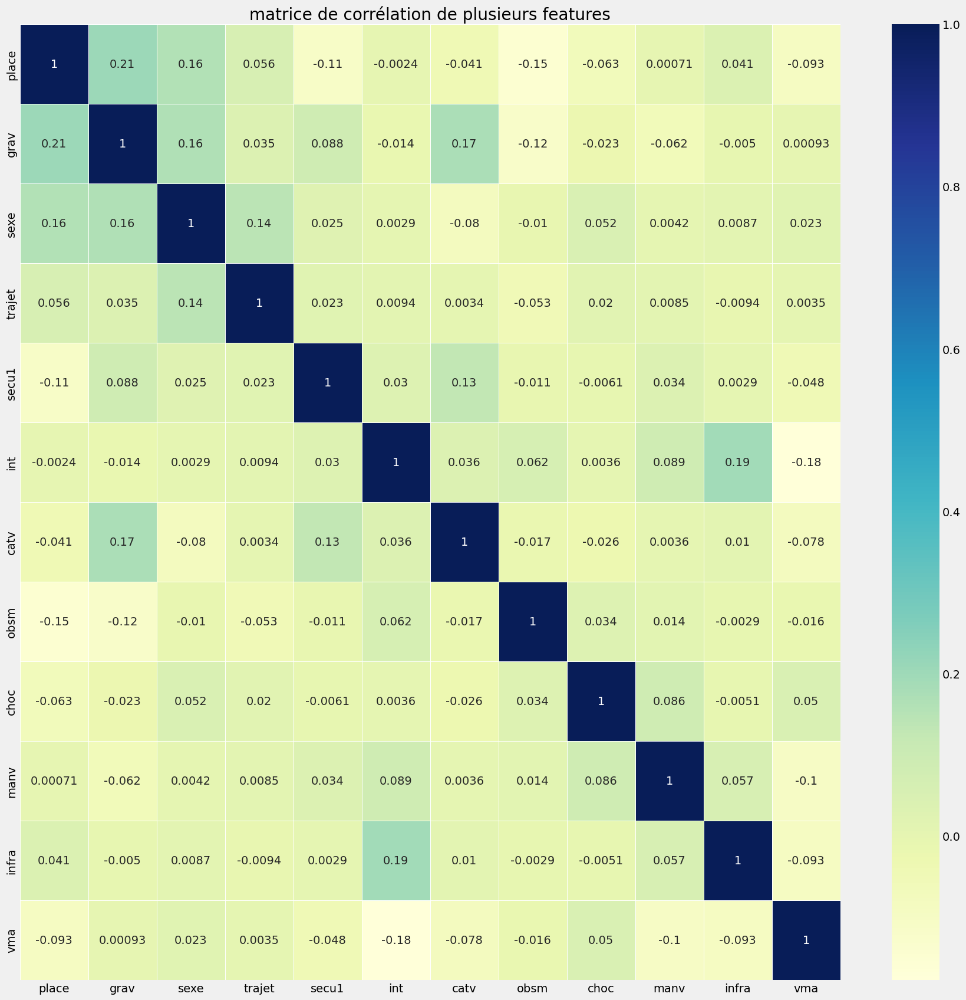

In [57]:
plt.figure(figsize=(20,20))
sns.heatmap(df[['place','grav', 'sexe','trajet', 'secu1','int',
       'catv','obsm', 'choc', 'manv','infra','vma']].corr(),annot=True,linewidth=.5,cmap='YlGnBu').set(title = "matrice de corrélation de plusieurs features")

#'infra', 'trajet' et 'manv' peuvent être retirés car ils sont corrélés à d'autres variables utilisés déjà en feature et sont ainsi peu utiles. 


[Text(0.5, 1.0, 'matrice de corrélation de plusieurs features')]

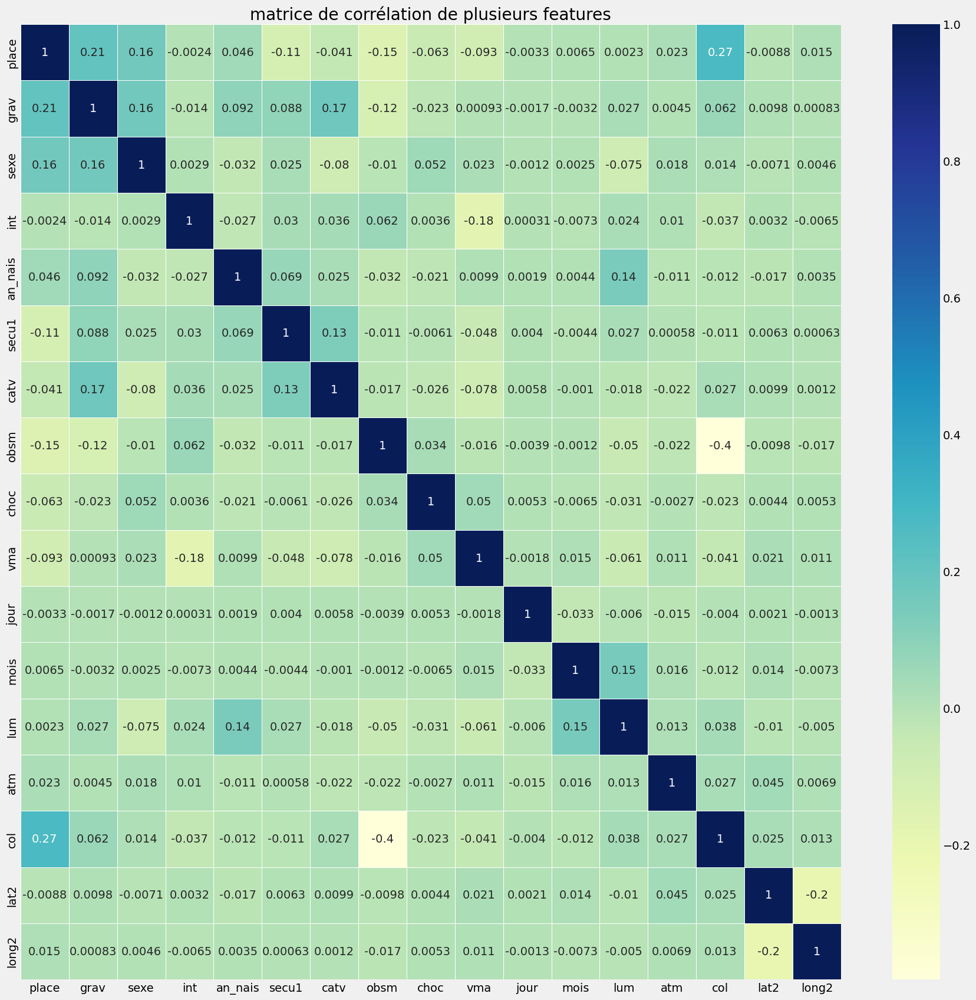

In [58]:
plt.figure(figsize=(20,20))
sns.heatmap(df[['place','grav','sexe','int','an_nais','secu1',
       'catv','obsm', 'choc', 'vma','jour', 'mois', 'hrmn', 'lum', 'dep', 'com', 'atm',
       'col', 'adr', 'lat2', 'long2']].corr(),annot=True,linewidth=.5,cmap='YlGnBu').set(title = "matrice de corrélation de plusieurs features")

'col' et 'obsm' ont une corrélation négative de -0.4 ce qui est élevé donc on n'en garde qu'un seul en feature ('obsm'). 
De plus, 'dep' et 'com' ne sont pas utiles puisqu'on dispose de la latitude et de la longitude. 
Les variables 'jour' et 'mois' ne seront pas utiles pour la prédiction, n'influant pas sur la gravité d'un accident.

In [20]:
df.drop(['trajet','catu',
       'obs', 'catr', 'circ', 'nbv', 'vosp',
       'prof', 'plan', 'surf', 'infra', 'situ', 'jour', 'mois', 'an',
       'hrmn', 'dep', 'com', 'agg', 'col', 'adr'], axis = 1, inplace = True)

In [188]:
df.columns

Index(['place', 'grav', 'sexe', 'an_nais', 'secu1', 'catv', 'obsm', 'choc',
       'manv', 'motor', 'vma', 'lum', 'int', 'atm', 'lat2', 'long2'],
      dtype='object')

In [59]:
indemne = len(df[df.grav == 1])
bléssé_léger = len(df[df.grav == 4])
bléssé_hospi = len(df[df.grav == 3])
tué = len(df[df.grav == 2])

indexNames = df[df['grav'] == -1 ].index
df.drop(indexNames ,inplace=True)

gravité = [indemne, bléssé_léger, bléssé_hospi, tué]

In [190]:
df

,place,grav,sexe,an_nais,secu1,catv,obsm,choc,manv,motor,vma,lum,int,atm,lat2,long2
0,1,3,1,2000.0,0,1,2,1,1,5,80,2,1,1,44.038958,4.348022
1,1,1,1,1978.0,1,7,9,3,17,1,80,2,1,1,44.038958,4.348022
2,1,4,1,1983.0,1,7,2,1,1,0,80,1,3,1,49.242129,4.554546
3,1,3,1,1993.0,1,7,2,1,9,0,80,1,3,1,49.242129,4.554546
4,1,1,1,1995.0,1,7,1,3,1,1,50,1,1,7,46.921950,-0.964460
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
129148,1,4,1,1975.0,1,7,2,1,5,1,80,3,1,2,44.911210,5.019636
129149,1,4,1,2002.0,1,7,2,3,1,1,80,3,1,2,44.911210,5.019636
129150,1,3,1,1999.0,0,7,0,5,6,1,80,1,2,1,44.954275,-0.517921
129151,1,3,1,1968.0,1,7,2,1,6,1,70,3,1,3,48.796670,2.050500


# Data visualisation et statistiques descriptives 

In [191]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 129093 entries, 0 to 129152
Data columns (total 16 columns):
 #   Column   Non-Null Count   Dtype  
---  ------   --------------   -----  
 0   place    129093 non-null  int64  
 1   grav     129093 non-null  int64  
 2   sexe     129093 non-null  int64  
 3   an_nais  126086 non-null  float64
 4   secu1    129093 non-null  int64  
 5   catv     129093 non-null  int64  
 6   obsm     129093 non-null  int64  
 7   choc     129093 non-null  int64  
 8   manv     129093 non-null  int64  
 9   motor    129093 non-null  int64  
 10  vma      129093 non-null  int64  
 11  lum      129093 non-null  int64  
 12  int      129093 non-null  int64  
 13  atm      129093 non-null  int64  
 14  lat2     129093 non-null  float64
 15  long2    129093 non-null  float64
dtypes: float64(3), int64(13)
memory usage: 16.7 MB


Seule la colonne an_nais possède des valeurs manquantes (3007). Nous nous en occuperons plus tard lors de la modélisation.

In [60]:
df.describe()

,Num_Acc,place,catu,grav,sexe,an_nais,trajet,secu1,senc,catv,...,jour,mois,an,lum,agg,int,atm,col,lat2,long2
count,1.290930e+05,129093.000000,129093.000000,129093.000000,129093.000000,126086.000000,129093.000000,129093.000000,129093.000000,129093.000000,...,129093.000000,129093.000000,129093.0,129093.000000,129093.000000,129093.000000,129093.000000,129093.000000,129093.000000,129093.000000
mean,2.021000e+11,2.035517,1.320319,2.521632,1.262532,1983.095427,3.164385,1.823623,1.553949,12.556668,...,15.788757,6.897694,2021.0,1.835661,1.625100,2.075519,1.618941,3.744920,44.275578,2.485148
std,1.628606e+04,2.526144,0.603735,1.379854,0.577182,18.744457,2.788772,2.239116,0.825593,13.273993,...,8.793912,3.287693,0.0,1.436492,0.484099,2.008508,1.697275,1.847788,12.254404,19.191624
min,2.021000e+11,1.000000,1.000000,1.000000,-1.000000,1912.000000,-1.000000,-1.000000,-1.000000,-1.000000,...,1.000000,1.000000,2021.0,1.000000,1.000000,1.000000,-1.000000,-1.000000,-23.395090,-178.085795
25%,2.021000e+11,1.000000,1.000000,1.000000,1.000000,1970.000000,0.000000,1.000000,1.000000,7.000000,...,8.000000,4.000000,2021.0,1.000000,1.000000,1.000000,1.000000,2.000000,44.557749,1.360090
50%,2.021000e+11,1.000000,1.000000,3.000000,1.000000,1987.000000,4.000000,1.000000,1.000000,7.000000,...,16.000000,7.000000,2021.0,1.000000,2.000000,1.000000,1.000000,3.000000,47.748534,2.399328
75%,2.021000e+11,1.000000,1.000000,4.000000,2.000000,1998.000000,5.000000,2.000000,2.000000,10.000000,...,23.000000,10.000000,2021.0,2.000000,2.000000,2.000000,1.000000,6.000000,48.858018,4.831950
max,2.021001e+11,10.000000,3.000000,4.000000,2.000000,2021.000000,9.000000,9.000000,3.000000,99.000000,...,31.000000,12.000000,2021.0,5.000000,2.000000,9.000000,9.000000,7.000000,51.057332,168.106549


On peut voir qu'une personne agée de 109 ans et un bébé de moins d'un an ont été impliqués dans des accidents en 2021.

In [61]:
df.loc[df['an_nais'] == 1912]

,place,grav,sexe,an_nais,secu1,catv,obsm,choc,manv,motor,vma,lum,int,atm,lat2,long2
4459,2,3,2,1912.0,1,7,2,4,1,1,50,5,1,1,44.84361,-0.51876


Cette personne de 109 ans a donc été hospitalisée. Elle était sur le siège passager lors de l'accident, sur une route limitée à 50 km/h, en pleine nuit avec éclairage public allumé.  

Nous remarquons aussi que la vitesse maximale est de 901 km/h. Nous pensons à une erreur de frappe, nous corrigeons donc cela en 90 km/h. Plus généralement, nous regardons la distribution des valeurs de vitesse. Nous changeons 300 en 30, de 500 à 520 en 50 et 700 et 770 en 70.

In [65]:
np.unique(df['vma'], return_counts = True)

(array([ -1,   1,   2,   3,   5,   6,   8,   9,  10,  12,  15,  20,  25,
         30,  40,  45,  50,  55,  60,  70,  75,  80,  90, 100, 110, 130,
        140, 180, 300, 500, 501, 502, 520, 700, 770, 900, 901]),
 array([ 1870,    34,    16,     2,    44,     7,     2,     3,   239,
            3,    51,   311,    41, 13542,   106,    35, 66260,     1,
          182,  9743,     3, 17019, 11034,    31,  5358,  3107,     2,
            2,     2,    14,     2,     3,     3,     3,     2,    11,
            5]))

In [66]:
abus = [300,500,501,502,520,700,770,900,901]

In [67]:
for i in range(len(abus)):
    e = abus[i]
    chiffre = e//100
    new_vma = float(str(chiffre)+str(0))
    req_Index = list(np.where(df["vma"] == e))
    for j in req_Index[0]:
        df.iloc[j,10] = new_vma

In [68]:
np.unique(df['vma'], return_counts = True)

(array([ -1,   1,   2,   3,   5,   6,   8,   9,  10,  12,  15,  20,  25,
         30,  40,  45,  50,  55,  60,  70,  75,  80,  90, 100, 110, 130,
        140, 180, 300, 500, 501, 502, 520, 700, 770, 900, 901]),
 array([ 1870,    34,    16,     2,    44,     7,     2,     3,   239,
            3,    51,   311,    41, 13542,   106,    35, 66260,     1,
          182,  9743,     3, 17019, 11034,    31,  5358,  3107,     2,
            2,     2,    14,     2,     3,     3,     3,     2,    11,
            5]))

In [69]:
def cat(annee):
    if annee >= 1996:
        return "moins de 25 ans"
    elif annee > 1961:
        return "entre 25 et 60 ans"
    else :
        return "plus de 60 ans"

In [70]:
df3 = df.copy()
df3['category_age'] = df['an_nais'].apply(cat)

[Text(0.5, 1.0, "distribution de la gravité en fonction de l'âge")]

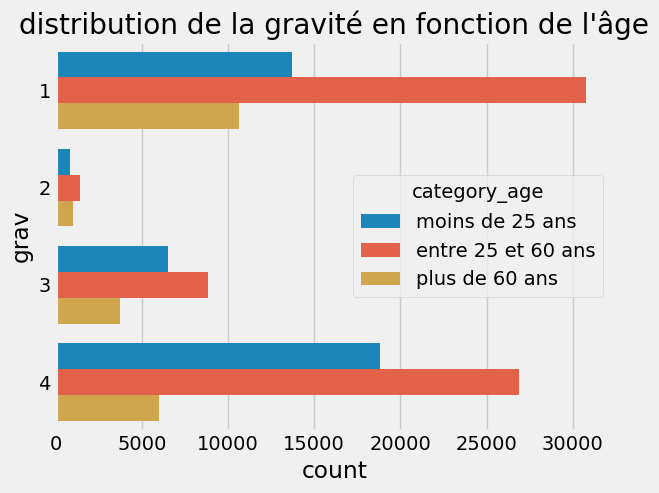

In [71]:
sns.countplot(y='grav',data=df3, hue ='category_age').set(title="distribution de la gravité en fonction de l'âge")

La catégorie avec le plus de conducteurs actifs est donc la plus représentée dans chacune des classes de gravité.

Longitude de la France métropolitaine est entre -4° et 8°, sa latitude entre 42° et 51°. La base de données ne se restreint donc pas seulement à la France métropolitaine, elle comprend aussi l'Outre-Mer français.

## Villes

In [76]:
communes = df2.com.unique()
len(communes)

AttributeError: 'DataFrame' object has no attribute 'com'

Les accidents reportés dans cette base de données ne se sont produits que dans moins de 12000 communes, sur plus de 36000 en France selon l'INSEE.

In [72]:
plt.figure(figsize=(10,5))
df2.dep.value_counts().sort_values(ascending=False)[:10].plot(kind='bar').set(title = "distribution du nombre d'accidents en fonction du département")

AttributeError: 'DataFrame' object has no attribute 'dep'

<Figure size 1000x500 with 0 Axes>

Sans surprise, la ville de Paris contient le plus grand nombre d'accidents routiers. Cela n'implique pas directement que conduire à Paris augmente la probabilité d'avoir un accident, il faut prendre en compte le nombre de voitures circulant dans la capitale.

In [45]:
paris =df2[df2['dep']=='75']
plt.figure(figsize=(10,15))
paris.com.value_counts().plot(kind='pie',autopct='%1.1f%%').set(title = "répartition des d'accidents parisiens en fonction de l'arrondissement")

centre_circle = plt.Circle((0, 0), 0.70, fc='white')
fig = plt.gcf()
  
# Adding Circle in Pie chart
fig.gca().add_artist(centre_circle)
  

KeyError: 'dep'

Le 16e arrondissement de Paris est celui qui comporte le plus d'accidents de la route 

In [ ]:
### Brouillon API noms de villes ###

In [48]:
code_commune="85048"
api_root="https://geo.api.gouv.fr/communes"
url_api = f"{api_root}?code="+ f"{code_commune}"  

import requests
import pandas as pd

req = requests.get(url_api)
wb = req.json()

df3 = pd.json_normalize(wb)

df3

""


In [45]:
df2

,Num_Acc,id_vehicule,num_veh,place,catu,grav,sexe,an_nais,trajet,secu1,...,lum,dep,com,agg,int,atm,col,adr,lat,long
0,202100000001,201 764,B01,1,1,3,1,2000.0,1,0,...,2,30,30319,1,1,1,1,CD 981,"44,0389580000","4,3480220000"
1,202100000001,201 765,A01,1,1,1,1,1978.0,1,1,...,2,30,30319,1,1,1,1,CD 981,"44,0389580000","4,3480220000"
2,202100000002,201 762,A01,1,1,4,1,1983.0,0,1,...,1,51,51544,1,3,1,3,Aire de repos croisement D20E9 après sortie D977,"49,2421290000","4,5545460000"
3,202100000002,201 763,B01,1,1,3,1,1993.0,0,1,...,1,51,51544,1,3,1,3,Aire de repos croisement D20E9 après sortie D977,"49,2421290000","4,5545460000"
4,202100000003,201 761,A01,1,1,1,1,1995.0,1,1,...,1,85,85048,2,1,7,6,15 rue François Nicolas,"46,9219500000","-0,9644600000"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
129148,202100056516,100 885,A01,1,1,4,1,1975.0,0,1,...,3,26,26064,1,1,2,1,Route départementale 538,"44,9112100000","5,0196360000"
129149,202100056516,100 886,B01,1,1,4,1,2002.0,5,1,...,3,26,26064,1,1,2,1,Route départementale 538,"44,9112100000","5,0196360000"
129150,202100056517,100 884,A01,1,1,3,1,1999.0,0,0,...,1,33,33003,1,2,1,6,Voie rapide Bassens Ambes,"44,9542747363","-0,5179211363"
129151,202100056518,100 882,A01,1,1,3,1,1968.0,3,1,...,3,78,78423,1,1,3,1,VOLTA (AVENUE),"48,7966700000","2,0505000000"


In [74]:
api_root="https://geo.api.gouv.fr/communes"  

import requests
import pandas as pd

req = requests.get(api_root)
wb = req.json()

df3 = pd.json_normalize(wb)

df3=df3[['nom','code']]
df3.columns = ['nom_villes', 'com']
df3

,nom_villes,com
0,L'Abergement-Clémenciat,01001
1,L'Abergement-de-Varey,01002
2,Ambérieu-en-Bugey,01004
3,Ambérieux-en-Dombes,01005
4,Ambléon,01006
...,...,...
35044,Touho,98830
35045,Voh,98831
35046,Yaté,98832
35047,Kouaoua,98833


In [75]:
df4 = pd.merge(df2,df3,how = 'left')
df4

import time
t1 = time.time()

for i in range(len(df4)):
    if df4['com'][i] in list(df2[df2['dep']=='75'].com):
        df4['nom_villes'][i]='Paris'
    

print(time.time()- t1)

    

MergeError: No common columns to perform merge on. Merge options: left_on=None, right_on=None, left_index=False, right_index=False

In [105]:
#df4.isnull().sum().sort_values(ascending=False)

In [41]:
plt.figure(figsize=(10,5))
df4.nom_villes.value_counts().sort_values(ascending=False)[:10].plot(kind='bar').set(title = "villes avec le plus d'accidents")

NameError: name 'df4' is not defined

<Figure size 1000x500 with 0 Axes>

In [ ]:
def get_city_from_url(code):
    try : 
        code_commune = code
        api_root="https://geo.api.gouv.fr/communes"
        url_api = f"{api_root}?code="+ f"{code_commune}"  
        req = requests.get(url_api)
        wb = req.json()

        a = pd.json_normalize(wb)
        return a['nom'][0]
    except : 
        return np.NaN 


df2['nom_villes']=df2['com'].apply(get_city_from_url)

df

In [568]:
api_root="https://geo.api.gouv.fr/communes"
req = requests.get(api_root)
wb = req.json()

df = pd.json_normalize(wb)

df[df['nom']=='Paris']



,nom,code,codeDepartement,siren,codeEpci,codeRegion,codesPostaux,population
29260,Paris,75056,75,217500016,200054781,11,"[75001, 75002, 75003, 75004, 75005, 75006, 750...",2165423.0


In [ ]:
### FIN BROUILLON API ###

In [141]:
df_sample = df[:3000]
df_sample

,place,grav,sexe,an_nais,catv,obsm,choc,motor,vma,lum,int,atm,lat2,long2,color
0,1,3,1,2000.0,1,2,1,5,80,2,1,1,44.038958,4.348022,#cdd9ec
1,1,1,1,1978.0,7,9,3,1,80,2,1,1,44.038958,4.348022,#82a6fb
2,1,4,1,1983.0,7,2,1,0,80,1,3,1,49.242129,4.554546,#ead4c8
3,1,3,1,1993.0,7,2,1,0,80,1,3,1,49.242129,4.554546,#cdd9ec
4,1,1,1,1995.0,7,1,3,1,50,1,1,7,46.921950,-0.964460,#82a6fb
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2998,4,1,2,2019.0,7,2,1,1,50,5,2,2,45.753600,4.895300,#82a6fb
2999,1,4,2,2001.0,7,2,3,1,50,5,2,2,45.753600,4.895300,#ead4c8
3000,2,1,1,2000.0,7,2,3,1,50,5,2,2,45.753600,4.895300,#82a6fb
3001,1,1,2,1998.0,7,2,4,1,50,1,9,1,45.735340,4.882620,#82a6fb


In [142]:
import folium

palette = sns.color_palette("coolwarm", 8)

def interactive_map(df):

    # convert in number
    df_sample['color'] = [int(df_sample.iloc[i]['grav']) for i in range(len(df_sample))]

    df_sample['color'] = [palette.as_hex()[x] for x in df_sample['color']]


    center = df_sample[['lat2', 'long2']].mean().values.tolist()
    sw = df_sample[['lat2', 'long2']].min().values.tolist()
    ne = df_sample[['lat2', 'long2']].max().values.tolist()

    m = folium.Map(location = center, tiles='Stamen Toner')

    # I can add marker one by one on the map
    for i in range(0,len(df)):

        folium.Marker([df_sample.iloc[i]['lat2'], df_sample.iloc[i]['long2']],
                    popup=f"Luminosité: {df_sample.iloc[i]['lum']}, <br>gravité: {df_sample.iloc[i]['grav']}, <br>vma: {df_sample.iloc[i]['vma']}",
                    icon=folium.Icon(icon='car', prefix='fa')).add_to(m)

    m.fit_bounds([sw, ne])

    return m

m = interactive_map(df_sample)

/var/folders/1c/nkg3ybs11lj6wgwvnb16pdl80000gn/T/ipykernel_40181/3835767472.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_sample['color'] = [int(df_sample.iloc[i]['grav']) for i in range(len(df_sample))]
/var/folders/1c/nkg3ybs11lj6wgwvnb16pdl80000gn/T/ipykernel_40181/3835767472.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_sample['color'] = [palette.as_hex()[x] for x in df_sample['color']]


In [1]:
m

NameError: name 'm' is not defined

In [155]:
pip install geojson

Note: you may need to restart the kernel to use updated packages.


In [156]:
import geopandas as gpd
import json
import geojson
departements = gpd.read_file('accident-route/departements-france.geojson')
departements.head()

,code,nom,geometry
0,01,Ain,"POLYGON ((4.78021 46.17668, 4.78024 46.18905, ..."
1,02,Aisne,"POLYGON ((3.17296 50.01131, 3.17382 50.01186, ..."
2,03,Allier,"POLYGON ((3.03207 46.79491, 3.03424 46.79080, ..."
3,04,Alpes-de-Haute-Provence,"POLYGON ((5.67604 44.19143, 5.67817 44.19051, ..."
4,05,Hautes-Alpes,"POLYGON ((6.26057 45.12685, 6.26417 45.12641, ..."


In [164]:
dep_accident = df2.dep.value_counts().to_frame().reset_index()
dep_accident["échelle d'incidence"]=np.log10(dep_accident['dep'])
dep_accident

,index,dep,échelle d'incidence
0,75,11157,4.047547
1,13,7029,3.846894
2,93,6819,3.833721
3,69,5772,3.761326
4,94,5722,3.757548
...,...,...,...
102,90,98,1.991226
103,978,87,1.939519
104,977,42,1.623249
105,986,23,1.361728


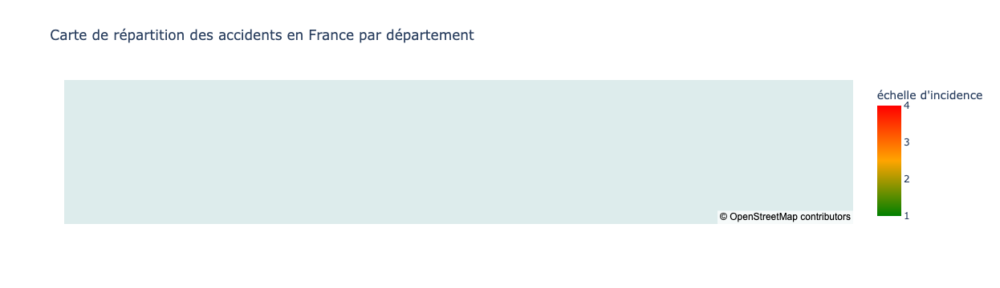

In [168]:
import plotly.express as px

fig1 = px.choropleth_mapbox(dep_accident, locations = 'index',
                            geojson= departements,
                            color="échelle d'incidence",
                            color_continuous_scale=["green","orange","red"],
                            range_color=[1,4],
                            hover_name='index',
                            hover_data=['dep'],
                            title="Carte de répartition des accidents en France par département",
                            mapbox_style="open-street-map",
                            center= {'lat':46, 'lon':2},
                            zoom =3.5, 
                            opacity= 0.6)

fig1.show()

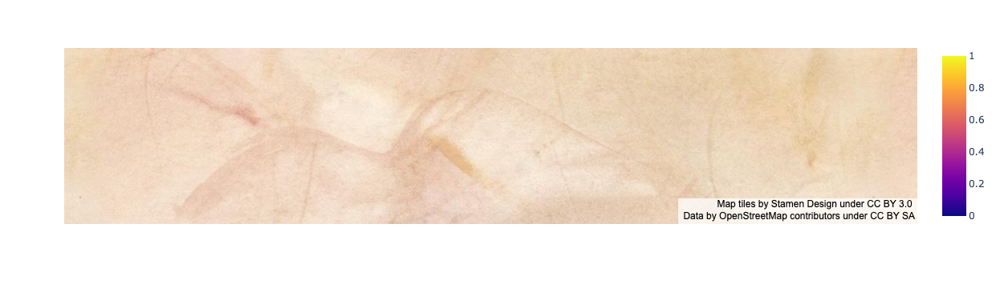

In [183]:
df_samp = df.sample(int(len(df)*0.01))

df_samp 
fig2 = px.density_mapbox(df_samp, lat='lat2',lon='long2', radius=10, center=dict(lat=48.9, lon=2.4), zoom=4,
                         mapbox_style="stamen-watercolor")
fig2.show()



# OU avec tous les accidents : moins lisible 
# df3 = df.copy()
# fig2 = px.density_mapbox(df3, lat='lat2',lon='long2', radius=10,
#                       center=dict(lat=48.9, lon=2.4), zoom=4,
#                       mapbox_style="stamen-watercolor")
# fig2.show()

## Heures d'accident 

In [251]:
def time(data):
    return datetime.strptime(data, "%H:%M").time()

df2['hrmn']=df2['hrmn'].apply(time)

TypeError: strptime() argument 1 must be str, not datetime.time

In [237]:
df.hrmn = pd.to_datetime(df.hrmn)
df.hrmn.dt.hour

0          7
1          7
2         14
3         14
4          7
          ..
129148    18
129149    18
129150    10
129151    18
129152    18
Name: hrmn, Length: 129153, dtype: int64

<AxesSubplot:xlabel='hrmn', ylabel='Count'>

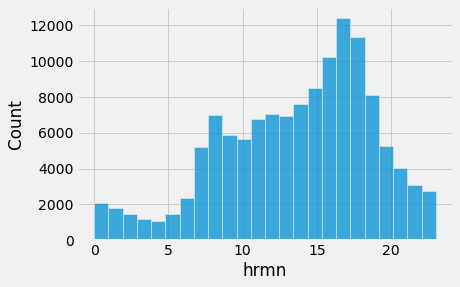

In [247]:
sns.histplot(df.hrmn.dt.hour,bins=24)

/Users/sachaapelbaum/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



<AxesSubplot:xlabel='hrmn', ylabel='Density'>

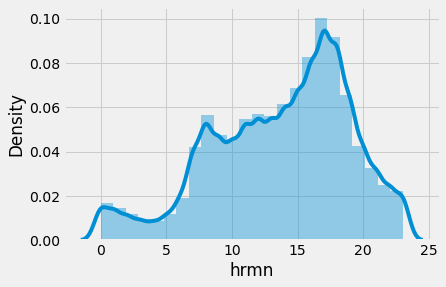

In [248]:
sns.distplot(df.hrmn.dt.hour,bins=24)

On observe d'un pic d'accidents vers 17h (heure de pointe donc plus de monde sur les routes donc plus d'accidents). 

### Jours de la semaine 

In [46]:
sns.histplot(df.jour,bins = 31).set(title = "distribution du nombre d'accidents en fonction du jour")

AttributeError: 'DataFrame' object has no attribute 'jour'

### Mois de l'année 

In [40]:
sns.histplot(df.mois,bins = 12).set(title = "distribution du nombre d'accidents en fonction du mois")

AttributeError: 'DataFrame' object has no attribute 'mois'

In [267]:
df.mois.dt.month

AttributeError: Can only use .dt accessor with datetimelike values

In [199]:
timestamp = datetime.timestamp((df2.hrmn)[0])

TypeError: descriptor 'timestamp' for 'datetime.datetime' objects doesn't apply to a 'datetime.time' object

<AxesSubplot:xlabel='hrmn', ylabel='Count'>

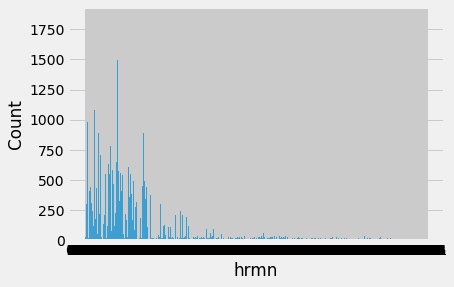

In [213]:
sns.histplot(df2.hrmn,bins=24)

In [11]:
df.drop(df.loc[df['grav']==-1].index, inplace=True)
df['grav'].value_counts()

1    55108
4    51681
3    19085
2     3219
Name: grav, dtype: int64

[Text(0.5, 1.0, 'classes de gravité')]

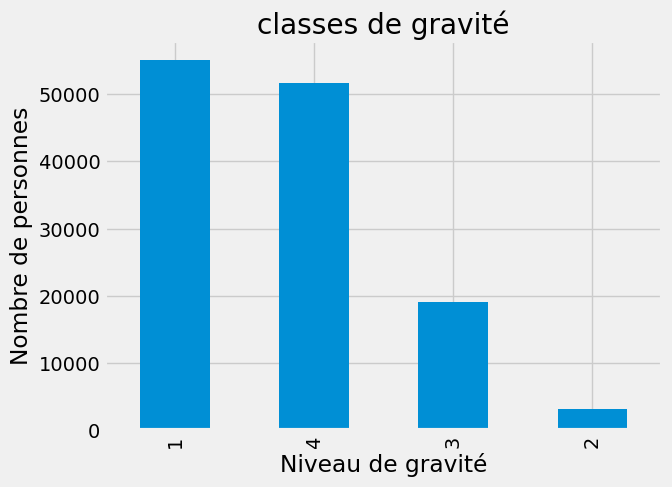

In [39]:
df.grav.value_counts().plot(kind='bar',xlabel='Niveau de gravité',ylabel='Nombre de personnes').set(title = "classes de gravité")

In [15]:
df.groupby('lum')['grav'].value_counts().plot

[Text(0.5, 1.0, 'distribution de la luminosité en fonction de la gravité')]

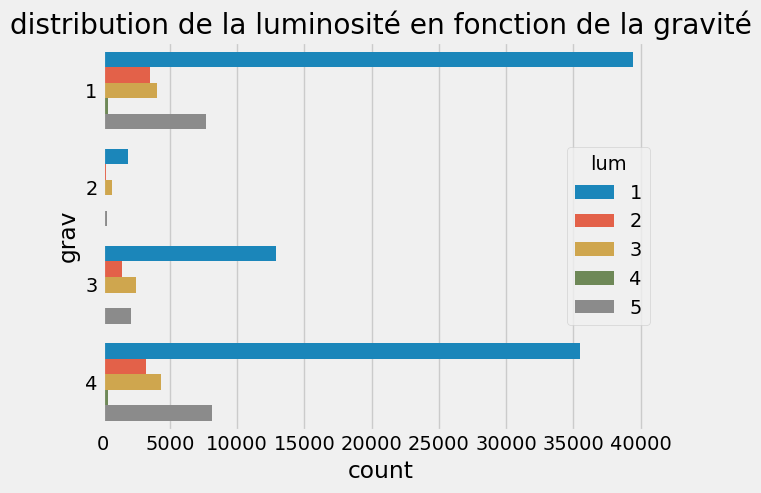

In [38]:
sns.countplot(y='grav',data=df,hue='lum').set(title = "distribution de la luminosité en fonction de la gravité")

Luminosité = 1 correspond au plein jour. Quelque soit la gravité, il y a beaucoup plus d'accidents le jour dû au nombre de voitures. Pour la gravité = 2 qui correspond à tué, on remarque que cela s'équilibre plus avec lum = 3 qui correspond à la nuit sans éclairage public. Cela semble cohérent : les conditions de circulation sont plus dangereuses.

[Text(0.5, 1.0, 'distribution du sexe en fonction de la gravité')]

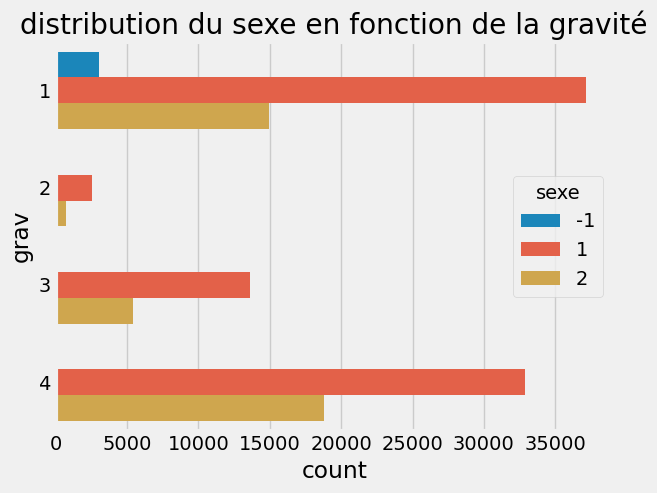

In [37]:
sns.countplot(y='grav',data=df,hue='sexe').set(title = "distribution du sexe en fonction de la gravité")

Quelque soit la gravité, il y a beaucoup plus d'hommes impliqués dans des accidents de voiture que de femmes.

In [31]:
def vitesse(speed):
    if speed < 50 : 
        return " moins de 50 km/h"
    elif speed < 80 :
        return "entre 50 et 80 km/h"
    elif speed < 130:
        return "entre 80 et 130 km/h"
    else:
        return "plus de 130 km/h"

In [32]:
dfvitesse = df.copy()
dfvitesse['category_speed'] = df['vma'].apply(vitesse)

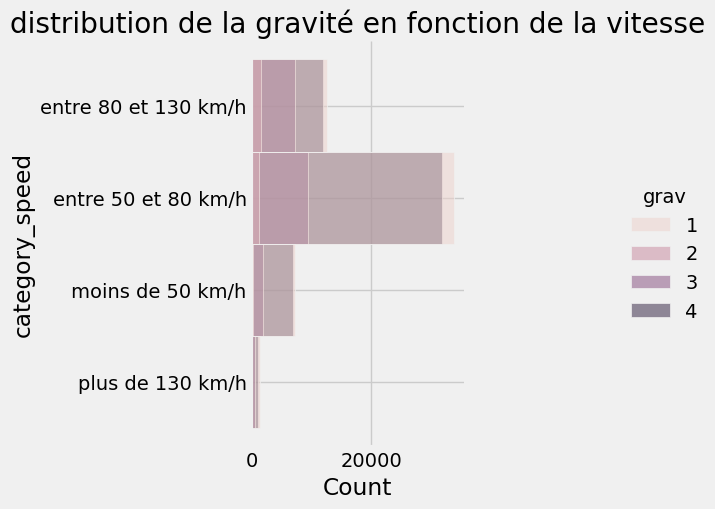

In [33]:
sns.displot(y='category_speed',data=dfvitesse,hue='grav').set(title="distribution de la gravité en fonction de la vitesse")

La grande majorité des accidents ont lieu entre 50 et 80 km/h. Cependant, les accidents les plus mortels se plus produisent à haute vitesse.

In [16]:
sns.histplot(df.Start_Time.dt.dayofweek,bins=7)
plt.xlabel('Weekdays')

AttributeError: 'DataFrame' object has no attribute 'Start_Time'

OverflowError: signed integer is greater than maximum

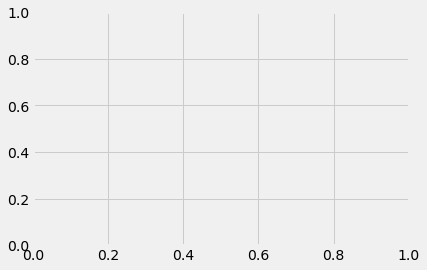

In [17]:
sns.scatterplot(x=df.long, y=df.lat)

In [18]:
import re 

def cleanData(data):
    data = re.sub(',','.',data) 
    return data

df['lat2']=df['lat'].apply(cleanData)
df['long2']=df['long'].apply(cleanData)

df["lat2"] = pd.to_numeric(df["lat2"])
df["long2"] = pd.to_numeric(df["long2"])

In [19]:
def cleanData(data):
    data = re.sub(',','.',data) 
    return data

In [20]:
df['lat2']=df['lat'].apply(cleanData)
df['long2']=df['long'].apply(cleanData)

In [21]:
df["lat2"] = pd.to_numeric(df["lat2"])
df["long2"] = pd.to_numeric(df["long2"])

<AxesSubplot:xlabel='long2', ylabel='lat2'>

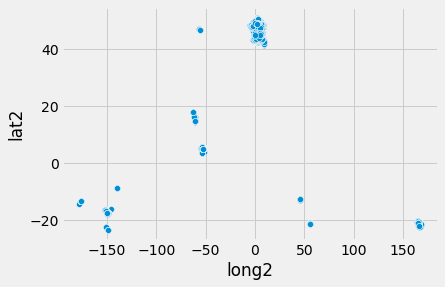

In [22]:
sns.scatterplot(x=df.long2, y=df.lat2)

In [147]:
pip install folium

     |████████████████████████████████| 96 kB 608 kB/s eta 0:00:01
Note: you may need to restart the kernel to use updated packages.


In [23]:
import folium 

In [24]:
from folium.plugins import HeatMap

In [25]:
liste = list(zip(list(df.lat2), list(df.long2)))

In [26]:
map = folium.Map()
HeatMap(liste).add_to(map)
map

## MODELISATION

In [394]:
dfmodel = df.copy()

In [395]:
dfmodel.columns

Index(['place', 'grav', 'sexe', 'an_nais', 'secu1', 'catv', 'obsm', 'choc',
       'manv', 'motor', 'vma', 'lum', 'int', 'atm', 'lat2', 'long2'],
      dtype='object')

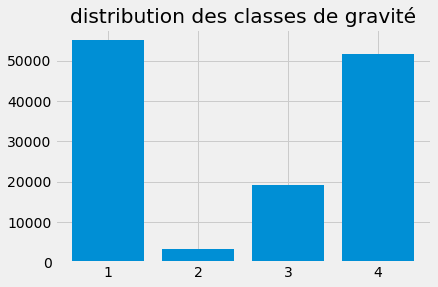

In [403]:
labels, counts = np.unique(dfmodel['grav'], return_counts=True)
plt.bar(labels, counts)
plt.gca().set_xticks(labels)
plt.title('distribution des classes de gravité')
plt.show()

On rappelle que les classes sont  : 1 = indemne, 2 = tué, 3 = hospitalisé, 4 = bléssé léger.
On remarque un fort déséquilibrage des classes visées pour la prédiction. En premier lieu, nous regroupons les tués et hospitalisés en une seule classe.

In [404]:
dfmodel['grav'] =  dfmodel['grav'].apply(lambda x: 2 if x == 3 else x) # fusion des classes 2 et 3.
dfmodel['grav'] =  dfmodel['grav'].apply(lambda x: 3 if x == 4 else x) # classe 4 devient la nouvelle classe 3
dfmodel['grav'] =  dfmodel['grav'].apply(lambda x: x-1) # première classe doit être 0

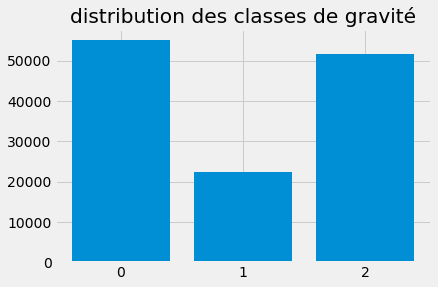

In [408]:
labels2, counts2 = np.unique(dfmodel['grav'], return_counts=True)
plt.bar(labels2, counts2)
plt.gca().set_xticks(labels2)
plt.title('distribution des classes de gravité')
plt.show()

Nous voulons ré-équilibrer les classes de gravité pour éviter un biais de prédiction. Pour cela, nous utilisons un algorithme d'over sampling, SMOTENC, qui gère aussi bien les données numériques que catégorielles.

In [409]:
dfmodel.columns

Index(['place', 'grav', 'sexe', 'an_nais', 'secu1', 'catv', 'obsm', 'choc',
       'manv', 'motor', 'vma', 'lum', 'int', 'atm', 'lat2', 'long2'],
      dtype='object')

In [410]:
Y = dfmodel['grav']
X = dfmodel.drop(['grav'],axis = 1)

In [411]:
X.isnull().sum()

place         0
sexe          0
an_nais    3007
secu1         0
catv          0
obsm          0
choc          0
manv          0
motor         0
vma           0
lum           0
int           0
atm           0
lat2          0
long2         0
dtype: int64

In [412]:
X['an_nais'].mean(),X['an_nais'].median()

(1983.095426930825, 1987.0)

On choisit de compléter les 3007 valeurs manquantes d'années de naissance par la médiane des années de naissance car elle est moins sensible aux valeurs aberrantes que la moyenne. 

In [413]:
median = X['an_nais'].median()
X['an_nais'].fillna(median, inplace=True)

Etant donné que nous avons un dataset déséquilibré avec beaucoup moins de valeurs de gravité égales à 1 (fusion des blessés hospitalisés et ds tués) que de valeurs égales à 0 ou 2 (indemnes et blessés légers), nous allons utiliser une méthode pour rééquilibrer le dataset appelé SMOTE NC. Le SMOTE, acronyme pour Synthetic Minority Oversampling TEchnique, est une méthode de suréchantillonnage des observations minoritaires. Il consiste à générer de nouveaux individus minoritaires qui ressemblent aux autres, sans être strictement identiques. Cela permet de densifier de façon homogène la population d’individus minoritaires. Cependant, le SMOTE classique ne permet pas de traiter les variables catégorielles. Pour traiter des données mixtes (mixed data), c’est-à-dire contenant à la fois des variables numériques et catégorielles, il faut utiliser une variante : le SMOTE-NC, pour SMOTE-Nominal Continuous.

In [414]:
var_categoriques = [0,1,3,4,5,6,7,8,10,11,12] #indices des colonnes de features catégoriques
smNC = SMOTENC(categorical_features=var_categoriques)
XsmotedNC, YsmotedNC = smNC.fit_resample(X,Y)

In [415]:
XsmotedNC.shape

(165324, 15)

In [416]:
XsmotedNC.head(2)

,place,sexe,an_nais,secu1,catv,obsm,choc,manv,motor,vma,lum,int,atm,lat2,long2
0,1,1,2000.0,0,1,2,1,1,5,80,2,1,1,44.038958,4.348022
1,1,1,1978.0,1,7,9,3,17,1,80,2,1,1,44.038958,4.348022


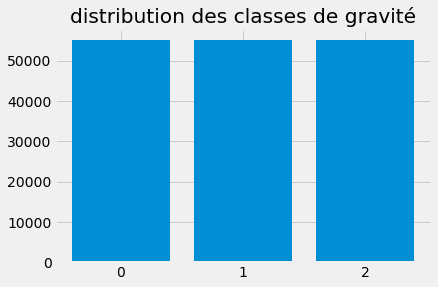

In [417]:
labels_reb, counts_reb = np.unique(YsmotedNC, return_counts=True)
plt.bar(labels_reb, counts_reb)
plt.gca().set_xticks(labels_reb)
plt.title('distribution des classes de gravité')
plt.show()

Nous avons bien ré-équilibré les classes comme nous le voulions. Ainsi, l'algorithme ne pourra plus prédire seulement la classe majoritaire afin d'assurer une bonne précision.

In [418]:
features = ['place','sexe','secu1','catv','obsm','choc','manv','motor','lum','int','atm'] # features catégoriques qu'on veut encoder

In [419]:
XsmotedNC2 = pd.get_dummies(XsmotedNC[features].astype(str)) # nous les encodons en indicatrices

In [420]:
XsmotedNC2['an_nais'] = XsmotedNC['an_nais'] # nous rajoutons les variables numériques à notre dataset
XsmotedNC2['vma'] = XsmotedNC['vma']
XsmotedNC2['lat2'] = XsmotedNC['lat2']
XsmotedNC2['long2'] = XsmotedNC['long2']

In [421]:
XsmotedNC2

,place_1,place_10,place_2,place_3,place_4,place_5,place_6,place_7,place_8,place_9,...,atm_4,atm_5,atm_6,atm_7,atm_8,atm_9,an_nais,vma,lat2,long2
0,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,2000.000000,80,44.038958,4.348022
1,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1978.000000,80,44.038958,4.348022
2,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1983.000000,80,49.242129,4.554546
3,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1993.000000,80,49.242129,4.554546
4,1,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,1995.000000,50,46.921950,-0.964460
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
165319,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1981.895206,30,48.848411,2.274684
165320,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1999.603219,80,47.364616,-0.255200
165321,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,2001.265131,81,46.810494,1.461484
165322,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1990.849442,50,48.027445,3.036902


In [422]:
Xtrain, Xtest, Ytrain, Ytest = train_test_split(XsmotedNC2,YsmotedNC)

### Premier modèle : Random Forest 

In [423]:
model_rf = RandomForestClassifier(n_estimators=100, 
                                  max_depth=8)
#nous testons un premier modèle de Random Forest avec des paramètres classiques.

In [425]:
model_rf.fit(Xtrain, Ytrain)
Ypredrf = model_rf.predict(Xtest)
test_acc = accuracy_score(Ytest, Ypredrf) 
# la métrique de précision aura dans toute la suite un sens car nos classes sont équilibrées. 
# Il faut donc faire mieux que 33% pour être meilleur que le hasard.
accu_rf = round(test_acc*100,1) 

In [426]:
accu_rf

63.9

Pour visualiser la performance de notre modèle, nous utiliserons une matrice de confusion. 
La matrice de confusion est en quelque sorte un résumé des résultats de prédiction pour un problème particulier de classification. Elle compare les données réelles pour une variable cible à celles prédites par un modèle. Les prédictions justes et fausses sont révélées et réparties par classe, ce qui permet de les comparer avec des valeurs définies.
D'une façon générale, ces matrices excellent dans l'analyse rapide des données statistiques et de la simplification du déchiffrement des résultats par le biais de la Data Vizualisation. Ainsi, elles permettent d'apprécier les performances d'un modèle et d'identifier les tendances qui peuvent permettre d'en modifier les paramètres.

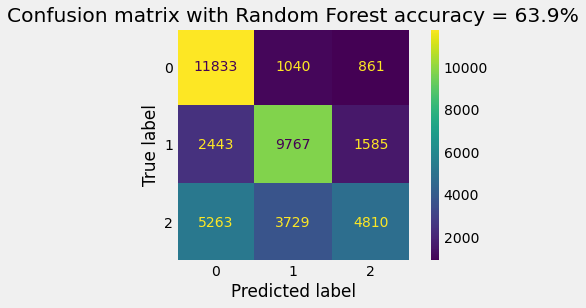

In [427]:
cmrf = confusion_matrix(Ytest, Ypredrf,labels=model_rf.classes_)
disprf = ConfusionMatrixDisplay(cmrf,display_labels=model_rf.classes_)
disprf.plot()
plt.grid(False)
plt.title('Confusion matrix with Random Forest accuracy = '+str(accu_rf)+'%')
plt.show()

On constate que la deuxième classe est très mal prédite. Nous utilisons maintenant une RandomSearch pour commencer à optimiser les hyperparamètres du modèle.

In [428]:
params_rf = {
    'n_estimators': [50,100,200],
    'max_depth': [3,5,7,9],
    'min_samples_leaf': [1, 2, 4],
    'min_samples_split': [2, 5, 10]
}
#nous créons notre grille d'hyperparamètres.

In [429]:
base_rfmodel = RandomForestClassifier()

In [430]:
folds = 3
param_comb = 7
# nous faisons de la 3-fold cross validation et nous testons 7 combinaisons d'hyperparamètres dans la RandomSearch.

In [431]:
skf = StratifiedKFold(n_splits=folds, shuffle = True, random_state =42)

random_search_rf = RandomizedSearchCV(base_rfmodel, param_distributions=params_rf, 
                                   n_iter=param_comb,scoring='accuracy', n_jobs=-1,
                                   cv=skf.split(Xtrain,Ytrain), verbose=3, random_state=42)

random_search_rf.fit(Xtrain,Ytrain)
# nous faisons de la random_search en cross-validation avec un paramètre de folds déjà défini plus haut. 

Fitting 3 folds for each of 7 candidates, totalling 21 fits


RandomizedSearchCV(cv=<generator object _BaseKFold.split at 0x7f7b90d33890>,
                   estimator=RandomForestClassifier(), n_iter=7, n_jobs=-1,
                   param_distributions={'max_depth': [3, 5, 7, 9],
                                        'min_samples_leaf': [1, 2, 4],
                                        'min_samples_split': [2, 5, 10],
                                        'n_estimators': [50, 100, 200]},
                   random_state=42, scoring='accuracy', verbose=3)

In [432]:
print(random_search_rf.cv_results_)

{'mean_fit_time': array([ 8.7637883 ,  2.77014049,  2.61271826, 11.08335988,  9.20376889,
        4.41886361,  1.71458062]), 'std_fit_time': array([0.37918234, 0.02559706, 0.12455614, 0.88707734, 1.0196349 ,
       0.71788813, 0.26502418]), 'mean_score_time': array([0.65404161, 0.2234935 , 0.21435467, 0.71919306, 0.57044633,
       0.2752041 , 0.1086967 ]), 'std_score_time': array([0.09818087, 0.00580872, 0.0254787 , 0.0117243 , 0.11700695,
       0.0362425 , 0.00710491]), 'param_n_estimators': masked_array(data=[200, 100, 100, 200, 200, 100, 50],
             mask=[False, False, False, False, False, False, False],
       fill_value='?',
            dtype=object), 'param_min_samples_split': masked_array(data=[5, 2, 5, 2, 10, 5, 5],
             mask=[False, False, False, False, False, False, False],
       fill_value='?',
            dtype=object), 'param_min_samples_leaf': masked_array(data=[4, 2, 1, 1, 1, 2, 1],
             mask=[False, False, False, False, False, False, False],
   

In [433]:
print(random_search_rf.best_estimator_)
#renvoie les modèle qui a obtenu la meilleure précision

RandomForestClassifier(max_depth=9, n_estimators=200)


In [434]:
print(random_search_rf.best_params_)

{'n_estimators': 200, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': 9}


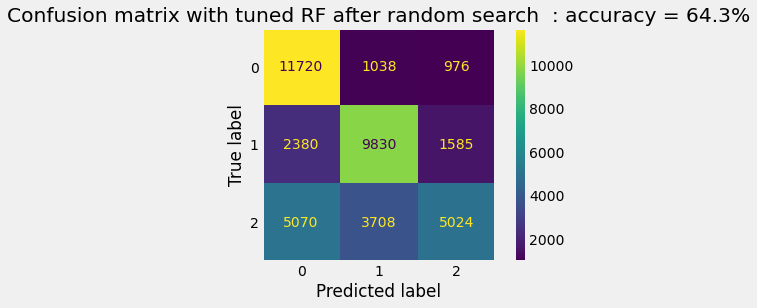

[CV 1/3] END max_depth=7, min_samples_leaf=4, min_samples_split=5, n_estimators=200;, score=0.631 total time=   9.1s
[CV 1/3] END max_depth=7, min_samples_leaf=2, min_samples_split=5, n_estimators=100;, score=0.633 total time=   4.6s
[CV 2/3] END max_depth=5, min_samples_leaf=1, min_samples_split=5, n_estimators=50;, score=0.615 total time=   1.7s
[CV 1/3] END max_depth=3, min_samples_leaf=1, min_samples_split=5, n_estimators=100;, score=0.610 total time=   3.0s
[CV 2/3] END max_depth=9, min_samples_leaf=1, min_samples_split=2, n_estimators=200;, score=0.647 total time=  12.9s
[CV 2/3] END max_depth=7, min_samples_leaf=4, min_samples_split=5, n_estimators=200;, score=0.630 total time=  10.1s
[CV 2/3] END max_depth=7, min_samples_leaf=2, min_samples_split=5, n_estimators=100;, score=0.633 total time=   5.7s
[CV 2/3] END max_depth=3, min_samples_leaf=1, min_samples_split=5, n_estimators=100;, score=0.603 total time=   2.7s
[CV 3/3] END max_depth=3, min_samples_leaf=1, min_samples_split=5

In [435]:
rf_best = random_search_rf.best_estimator_ # on utilise le meilleur modèle de notre RandomSearch
rf_best.fit(Xtrain,Ytrain)

Ypredrf_best = rf_best.predict(Xtest)
test_acc_rf_best = accuracy_score(Ytest, Ypredrf_best)
accu_rf_best = round(test_acc_rf_best,3)*100

cmrf_best = confusion_matrix(Ytest, Ypredrf_best,labels=rf_best.classes_)
disprf_best = ConfusionMatrixDisplay(cmrf_best,display_labels=rf_best.classes_)
disprf_best.plot()
plt.title('Confusion matrix with tuned RF after random search  : accuracy = '+str(accu_rf_best)+'%')
plt.grid(False)
plt.show()

In [446]:
# Affinage avec GridSearch 

RandomSearch permet de tester aléatoirement des combinaisons pour trouver des hyperparamètres. Ainsi, cela nous a permis d'avoir une vision générale et approximative des hyperparamètres. Maintenant, on peut utiliser un Gridsearch qui teste toites les combianisons qu'on lui indique afin d'optimiser et d'affiner les hyperparamètres. 

In [437]:
params_grid_rf = {
    'n_estimators': [150,175,200],
    'max_depth': [8,9,10,11],
    'min_samples_leaf': [1, 2,3],
    'min_samples_split': [1,2,3,4]
}
#nous créons notre grille d'hyperparamètres affinée pour le GridSearch.

In [438]:
base_rfmodel = RandomForestClassifier()

In [439]:
folds = 3

# nous faisons de la 3-fold cross validation 

In [441]:
skf = StratifiedKFold(n_splits=folds, shuffle = True, random_state =42)

grid_search_rf = GridSearchCV(base_rfmodel, param_grid=params_grid_rf, scoring='accuracy', n_jobs=-1,
                                   cv=skf.split(Xtrain,Ytrain), verbose=3)

grid_search_rf.fit(Xtrain,Ytrain)
# nous faisons de la random_search en cross-validation avec un paramètre de folds déjà défini plus haut. 

Fitting 3 folds for each of 144 candidates, totalling 432 fits


GridSearchCV(cv=<generator object _BaseKFold.split at 0x7f7bb1ff1cf0>,
             estimator=RandomForestClassifier(), n_jobs=-1,
             param_grid={'max_depth': [8, 9, 10, 11],
                         'min_samples_leaf': [1, 2, 3],
                         'min_samples_split': [1, 2, 3, 4],
                         'n_estimators': [150, 175, 200]},
             scoring='accuracy', verbose=3)

In [447]:
#print(grid_search_rf.cv_results_)

In [443]:
print(grid_search_rf.best_estimator_)
#renvoie les modèle qui a obtenu la meilleure précision

RandomForestClassifier(max_depth=11, min_samples_leaf=2, n_estimators=175)


In [444]:
print(grid_search_rf.best_params_)

{'max_depth': 11, 'min_samples_leaf': 2, 'min_samples_split': 2, 'n_estimators': 175}


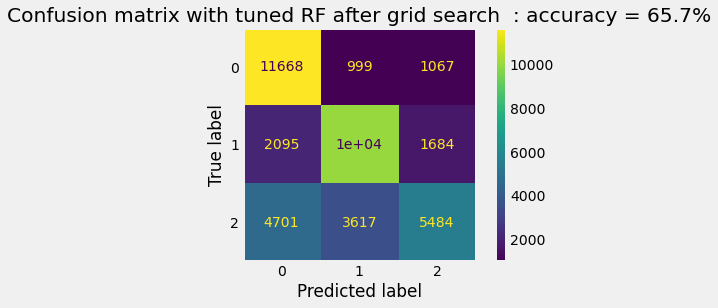

In [445]:
rf_best = grid_search_rf.best_estimator_ # on utilise le meilleur modèle de notre RandomSearch
rf_best.fit(Xtrain,Ytrain)

Ypredrf_best = rf_best.predict(Xtest)
test_acc_rf_best = accuracy_score(Ytest, Ypredrf_best)
accu_rf_best = round(test_acc_rf_best,3)*100

cmrf_best = confusion_matrix(Ytest, Ypredrf_best,labels=rf_best.classes_)
disprf_best = ConfusionMatrixDisplay(cmrf_best,display_labels=rf_best.classes_)
disprf_best.plot()
plt.title('Confusion matrix with tuned RF after grid search  : accuracy = '+str(accu_rf_best)+'%')
plt.grid(False)
plt.show()

Le gridsearch était plutôt long (10 minutes) et le gain négligeable, il est raisonnable de passer à un autre modèle que les random forests

### Deuxième modèle : XGBoost

XGBoost est un algorithme de machine learning appartenant à la classe des alogrithmes utilisant le Gradient Boosting. Cela signifie qu'il ne construit pas une forêt d'arbres de décision indépendants pour prédire mais au contraire qu'il construit chaque nouvel arbre de décision en utilisant les erreurs commises par les précédents. L'apprentissage est donc séquentiel et non plus en parallèle.

XGBoost est notamment très utilisé pour les compétitions Kaggle et notamment par les vainqueurs, il domine actuellement les autres algorithmes en termes de performance et de vitesse.

In [448]:
model_xgb = XGBClassifier(objective='multi:softprob',learning_rate=0.3,max_depth=4,subsample=0.75,n_estimators=150) # nous testons un premier modèle
# avec des paramètres pris au hasard

In [ ]:
model_xgb.fit(Xtrain,Ytrain)

Ypredxgb = model_xgb.predict(Xtest)
test_acc_xgb = accuracy_score(Ytest, Ypredxgb)
accu_xgb = round(test_acc_xgb*100,1)

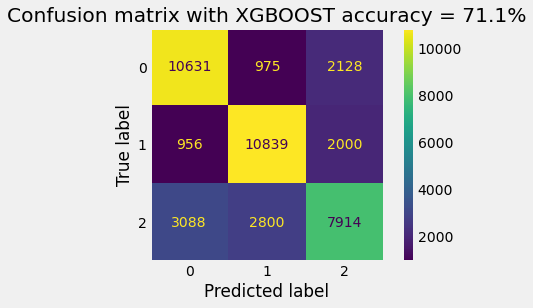

In [450]:
cmxgb = confusion_matrix(Ytest, Ypredxgb,labels=model_xgb.classes_)
dispxgb = ConfusionMatrixDisplay(cmxgb,display_labels=model_xgb.classes_)
dispxgb.plot()
plt.title('Confusion matrix with XGBOOST accuracy = '+str(accu_xgb)+'%')
plt.grid(False)
plt.show()

In [451]:
params_xgb = {
        'min_child_weight': [1, 5, 10],
        'gamma': [0.5, 1, 1.5, 2, 5],
        'subsample': [0.6, 0.8, 1.0],
        'max_depth': [3, 4, 5],
        'learning_rate' : [0.1,0.3,0.5,0.7],
        'n_estimators': [75,100,150,200]
        }
# nous créons notre grille d'hyperparamètres à tester

In [452]:
xgb = XGBClassifier(objective='multi:softprob',silent=True, nthread=1)

In [ ]:
skf = StratifiedKFold(n_splits=folds, shuffle = True, random_state =42,)

random_search_xgb = RandomizedSearchCV(xgb, param_distributions=params_xgb, 
                                   n_iter=param_comb,scoring='accuracy',
                                   cv=skf.split(Xtrain,Ytrain), verbose=3, random_state=42)

random_search_xgb.fit(Xtrain,Ytrain)
# nous faisons de la random_search en cross-validation avec un paramètre de folds déjà défini plus haut. 

Fitting 3 folds for each of 7 candidates, totalling 21 fits
[14:48:46] WARNING: /Users/runner/work/xgboost/xgboost/python-package/build/temp.macosx-10.9-x86_64-cpython-38/xgboost/src/learner.cc:767: 
Parameters: { "silent" } are not used.

[CV 1/3] END gamma=1, learning_rate=0.7, max_depth=5, min_child_weight=10, n_estimators=150, subsample=1.0;, score=0.728 total time= 2.8min
[14:51:35] WARNING: /Users/runner/work/xgboost/xgboost/python-package/build/temp.macosx-10.9-x86_64-cpython-38/xgboost/src/learner.cc:767: 
Parameters: { "silent" } are not used.

[CV 2/3] END gamma=1, learning_rate=0.7, max_depth=5, min_child_weight=10, n_estimators=150, subsample=1.0;, score=0.727 total time= 2.8min
[14:54:22] WARNING: /Users/runner/work/xgboost/xgboost/python-package/build/temp.macosx-10.9-x86_64-cpython-38/xgboost/src/learner.cc:767: 
Parameters: { "silent" } are not used.



In [ ]:
print(random_search_xgb.cv_results_)

In [ ]:
print(random_search_xgb.best_estimator_)

In [ ]:
print(random_search_xgb.best_params_)

In [ ]:
xgb_best = random_search_xgb.best_estimator_
xgb_best.fit(Xtrain,Ytrain)

Ypredxgb_best = xgb_best.predict(Xtest)
test_acc_xgb_best = accuracy_score(Ytest, Ypredxgb_best)
accu_xgb_best = round(test_acc_xgb_best,3)*100

cmxgb_best = confusion_matrix(Ytest, Ypredxgb_best,labels=xgb_best.classes_)
dispxgb_best = ConfusionMatrixDisplay(cmxgb_best,display_labels=xgb_best.classes_)
dispxgb_best.plot()
plt.grid(False)
plt.title('Confusion matrix with tuned XGBOOST after random search  : accuracy = '+str(accu_xgb_best)+'%')
plt.show()

On remarque que les classes 0 (indemne) et 1 (tué et bléssé hospitalisé) sont plutôt bien prédites par notre modèle. A l'inverse, la classe 2 (bléssé léger) semble être un peu moins évidente à prédire pour notre modèle.

Pour info, 2 bons modèles : gamma=1, learning_rate=0.7, max_depth=5, min_child_weight=10, n_estimators=150, subsample=1.0
et gamma=1.5, learning_rate=0.7, max_depth=5, min_child_weight=10, n_estimators=200, subsample=0.8

In [ ]:
# Affinage avec GridSearch 

In [ ]:
params_grid_rf = {
    'n_estimators': [150,175,200],
    'max_depth': [8,9,10,11],
    'min_samples_leaf': [1, 2,3],
    'min_samples_split': [1,2,3,4]
}
#nous créons notre grille d'hyperparamètres affinée pour le GridSearch.

In [ ]:
base_rfmodel = RandomForestClassifier()

folds = 3
# nous faisons de la 3-fold cross validation 

skf = StratifiedKFold(n_splits=folds, shuffle = True, random_state =42)

grid_search_rf = GridSearchCV(base_rfmodel, param_grid=params_grid_rf, scoring='accuracy', n_jobs=-1,
                                   cv=skf.split(Xtrain,Ytrain), verbose=3)

grid_search_rf.fit(Xtrain,Ytrain)
# nous faisons de la random_search en cross-validation avec un paramètre de folds déjà défini plus haut. 

print(grid_search_rf.cv_results_)
print(grid_search_rf.best_estimator_)
#renvoie les modèle qui a obtenu la meilleure précision
print(grid_search_rf.best_params_)

rf_best = grid_search_rf.best_estimator_ # on utilise le meilleur modèle de notre RandomSearch
rf_best.fit(Xtrain,Ytrain)

Ypredrf_best = rf_best.predict(Xtest)
test_acc_rf_best = accuracy_score(Ytest, Ypredrf_best)
accu_rf_best = round(test_acc_rf_best,3)*100

cmrf_best = confusion_matrix(Ytest, Ypredrf_best,labels=rf_best.classes_)
disprf_best = ConfusionMatrixDisplay(cmrf_best,display_labels=rf_best.classes_)
disprf_best.plot()
plt.title('Confusion matrix with tuned RF after grid search  : accuracy = '+str(accu_rf_best)+'%')
plt.grid(False)
plt.show()

In [ ]:
base_rfmodel = RandomForestClassifier()

In [ ]:
folds = 3
# nous faisons de la 3-fold cross validation 

In [ ]:
skf = StratifiedKFold(n_splits=folds, shuffle = True, random_state =42)

grid_search_rf = GridSearchCV(base_rfmodel, param_grid=params_grid_rf, scoring='accuracy', n_jobs=-1,
                                   cv=skf.split(Xtrain,Ytrain), verbose=3)

grid_search_rf.fit(Xtrain,Ytrain)
# nous faisons de la random_search en cross-validation avec un paramètre de folds déjà défini plus haut. 

In [ ]:
print(grid_search_rf.cv_results_)

print(grid_search_rf.best_estimator_)

#renvoie les modèle qui a obtenu la meilleure précision
print(grid_search_rf.best_params_)

In [ ]:
rf_best = grid_search_rf.best_estimator_ # on utilise le meilleur modèle de notre RandomSearch
rf_best.fit(Xtrain,Ytrain)

Ypredrf_best = rf_best.predict(Xtest)
test_acc_rf_best = accuracy_score(Ytest, Ypredrf_best)
accu_rf_best = round(test_acc_rf_best,3)*100

cmrf_best = confusion_matrix(Ytest, Ypredrf_best,labels=rf_best.classes_)
disprf_best = ConfusionMatrixDisplay(cmrf_best,display_labels=rf_best.classes_)
disprf_best.plot()
plt.title('Confusion matrix with tuned RF after grid search  : accuracy = '+str(accu_rf_best)+'%')
plt.grid(False)
plt.show()

### Troisième modèle : SVM

L’une des méthodes de Machine Learning les plus utilisées en classification est les SVM (Support Vector Machines). Il s’agit de trouver, dans un système de projection adéquat (noyau ou kernel), les paramètres de l’hyperplan (en fait d’un hyperplan à marges maximales) séparant les classes de données:

In [ ]:
model_svm = 

## FEATURE IMPORTANCE & SHAP

On veut maintenant savoir sur quelles informations se base notre modèle pour effectuer ses prédéctions. En d'autres termes, quelles sont les variables les plus influentes pour prédire la gravité d'un accident de voiture ?

Pour cela, nous allons dans un premier temps utiliser la méthode de feature importance de scikit-learn puis la bibliothèque SHAP.

In [58]:
xgb_best.feature_importances_

array([0.00874332, 0.02389341, 0.00209227, 0.00233393, 0.00175264,
       0.00189877, 0.00092784, 0.00182284, 0.00135076, 0.00300203,
       0.168814  , 0.00840412, 0.01103783, 0.08512536, 0.00631333,
       0.0750414 , 0.01566914, 0.03920075, 0.00060621, 0.        ,
       0.00061945, 0.        , 0.0263948 , 0.00290363, 0.        ,
       0.00041497, 0.01283531, 0.00390531, 0.00415431, 0.00407674,
       0.00761482, 0.        , 0.00400322, 0.00311615, 0.00099414,
       0.01330687, 0.00122022, 0.00968974, 0.00272072, 0.00331162,
       0.00582914, 0.00194101, 0.        , 0.00067943, 0.00411445,
       0.00444903, 0.00303946, 0.00334581, 0.        , 0.        ,
       0.00127414, 0.00464877, 0.00212862, 0.01111574, 0.00213098,
       0.00166682, 0.        , 0.03819736, 0.03903815, 0.01360234,
       0.00165858, 0.00107006, 0.0003413 , 0.01206829, 0.0020295 ,
       0.0021054 , 0.00865435, 0.00192955, 0.00230119, 0.01059446,
       0.00997573, 0.01190166, 0.00219235, 0.00308207, 0.00586

<BarContainer object of 139 artists>

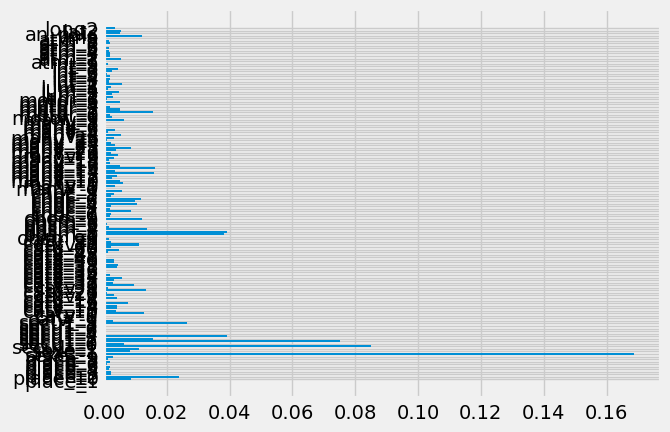

In [59]:
plt.barh(Xtrain.columns, xgb_best.feature_importances_)

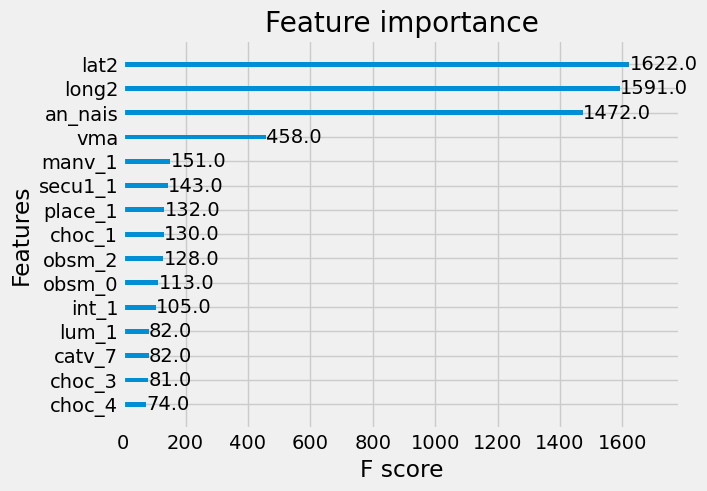

In [233]:
xgboost.plot_importance(xgb_best,max_num_features=15)
plt.title("Feature importance")
plt.show()

In [ ]:
!pip install shap

In [50]:
import shap

In [51]:
explainer = shap.Explainer(xgb_best, Xtrain)
shap_values = explainer(Xtrain)

100%|===================| 371977/371979 [41:27<00:00]        

In [54]:
shap_values

.values =
array([[[ 3.62180489e-02, -2.49436798e-04, -7.66852041e-02],
        [ 2.76047492e-01, -2.40678612e-02,  1.55277332e-02],
        [ 4.86285780e-03,  7.72785302e-05,  0.00000000e+00],
        ...,
        [ 9.18404823e-02,  1.54996336e-01, -4.00208762e-02],
        [-1.20353167e-01,  2.14511736e-01, -1.55699051e-01],
        [-2.15961636e-02,  3.16820037e-01, -2.84747022e-01]],

       [[-1.18619723e-03, -4.70780952e-02, -1.02549442e-01],
        [ 2.18009131e-01, -2.89516222e-02, -3.44851797e-03],
        [ 2.38762353e-03,  6.23513846e-03,  0.00000000e+00],
        ...,
        [-1.35716776e-01, -2.42912845e-01,  6.38003295e-02],
        [ 4.19669651e-01, -9.91426986e-02, -2.86336390e-01],
        [ 2.33091414e-01,  1.35679721e-02,  1.02591289e-01]],

       [[-1.96737102e-04,  6.89558814e-03, -5.87486171e-02],
        [ 2.81495252e-01, -2.45502615e-02,  3.25258893e-03],
        [-1.24484203e-03,  2.94515120e-04,  0.00000000e+00],
        ...,
        [-2.20567657e-01,  1.588

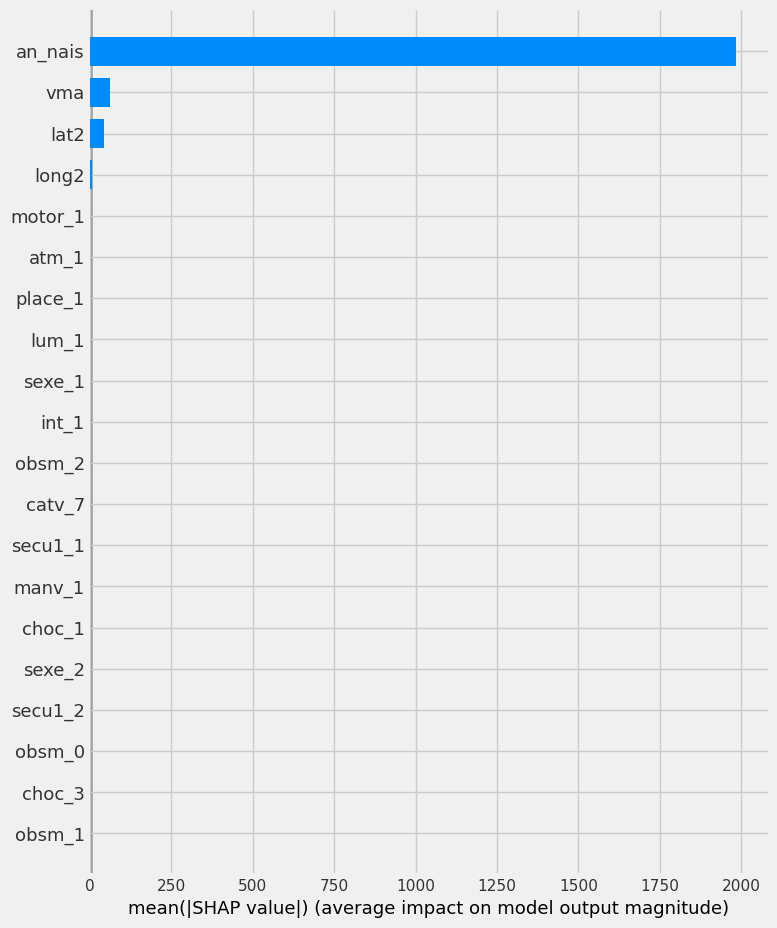

In [57]:
shap.summary_plot(shap_values.data, Xtrain, plot_type="bar")